### Datasource for this is National Grid ESO
https://data.nationalgrideso.com/system/gis-boundaries-for-gb-grid-supply-points

In [2]:
import pandas as pd
import geopandas as gpd

In [3]:
gdf = gpd.read_file('../GSP_regions_20220314.shp')

In [4]:
gdf.head(3)

,GSPs,GSPGroup,geometry
0,BRED_1,_G,"POLYGON ((396643.822 382551.233, 396689.851 38..."
1,CARR_1,_G,"POLYGON ((368430.177 388922.626, 368596.252 39..."
2,HARK_1|HUTT_1|RRIG,_G,"POLYGON ((373761.066 465853.110, 373759.920 46..."


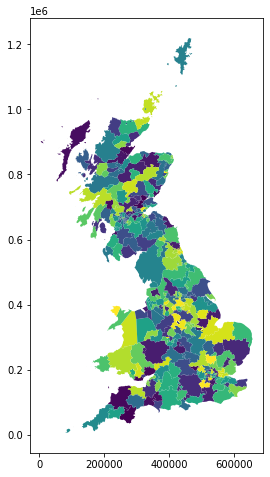

In [6]:
# A plot of all the different GSPs boundaries in the UK 

gdf.plot(figsize=(8,8), column="GSPs", cmap="viridis");

In [60]:
df = pd.read_csv('../gsp_gnode_directconnect_region_lookup.csv')
df.head(3)

,ng_id,ggd_id,gnode_id,gnode_name,gnode_lat,gnode_lon,gsp_id,gsp_name,gsp_lat,gsp_lon,dc_id,dc_name,dc_lat,dc_lon,region_id,region_name,has_pv,pes_id,pes_name
0,1,1,1.0,COWL,51.71105,-1.18901,1.0,COWL_1,51.71105,-1.18901,NaN,NaN,NaN,NaN,1.0,Cowley,1,20.0,_H
1,2,2,2.0,ECLA,51.92579,-0.90565,2.0,ECLA_1,51.92579,-0.90565,NaN,NaN,NaN,NaN,19.0,East Claydon,1,11.0,_B
2,3,3,3.0,ENDEDW,52.59726,-1.21548,3.0,ENDE_1,52.59726,-1.21548,NaN,NaN,NaN,NaN,20.0,Enderby,1,11.0,_B


In [11]:
df_gsp_name_list = df.gsp_name.to_list()
gdf_gsp_name_list = gdf.GSPs.to_list() 

# print(df_gsp_name_list)
# print(gdf_gsp_name_list)

In [79]:
# print(len(df_gsp_name_list))
# print(len(gdf_gsp_name_list))
# print(len(list(set(df_gsp_name_list) & set(gdf_gsp_name_list))))

In [78]:
# Quite a lot of overlap

# print('df cols', df.columns)
# print('gdf cols', gdf.columns)

In [57]:
gdf = gdf.rename(columns={"GSPs":"gsp_name"})

In [61]:
comb = gdf.merge(df, on="gsp_name").set_index("gsp_name")

In [21]:
import plotly.express as px

In [68]:
import pyproj

# Issue was with the projection

comb.to_crs(pyproj.CRS.from_epsg(4326), inplace=True)


In [81]:
fig = px.choropleth(comb, geojson=comb.geometry, locations=comb.index, color="pes_id", projection="mercator", color_continuous_scale="Viridis")
fig.update_geos(fitbounds="locations", visible=False)

fig.update_layout(
    autosize=False,
    width=1000,
    height=1500,)

fig.show(figsize=(20,20))